<a href="https://colab.research.google.com/github/simonmfr/P6-ST/blob/main/Vizgen_Showcase_Mouse_Brain.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Vizgen Mouse Brain Receptor Map

The Vizgen mouse brain receptor map measured 483 genes across 9 full coronal slices

This colab notebook loads and visualizes single cell transcriptomics and imaging data from a Vizgen MERFISH experiment. The notebook demonstrates how to load and plot the output from a MERSCOPE measurement, including:

1.   The DAPI staining across the full tissue slice
2.   The detected transcripts across the full tissue slice
3.   The detected transcritps, DAPI image, and cell boundaries within a single field of view

In addition to performing single cell analysis to cluster cell types and plots:
1.   A UMAP colored by the cell clusters
2.   A heatmap of the gene expression within each cell type cluster
3.   An interactive UMAP/spatial coordinate plot


### Authenticate via Google

Accessing the data requires authentication via Google. Please follow the instructions that appear after running the first cell to access the dataset, which include clicking a link, authenticating and enabling Google storage access, and copying a code back into the cell.

In [ ]:
from google.colab import auth
auth.authenticate_user()

### Install and import dependencies

In [ ]:
%%capture
!pip install -q fsspec
!pip install -q gcsfs
!pip install -q tifffile

import tifffile
import cv2
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import h5py
from copy import deepcopy

### Define paths to the data

In [ ]:
base_path = 'gs://public-datasets-vizgen-merfish/datasets/mouse_brain_map/BrainReceptorShowcase/'

slice_num = 2
replicate_num = 1
dataset_name = 'Slice' + str(slice_num) + '/Replicate' + str(replicate_num) + '/'
dataset_suffix = '_S' + str(slice_num) + 'R' + str(replicate_num)
z_index_number = 2

fov = 75

### Load Transformation Matrix
This is used to transfer from global coordinates (the coordinates of transcripts and cells across the sample) to mosaic coordinates (used for the large TIF image files).

In [ ]:
# load transformation matrix 
filename = base_path + dataset_name + 'images/micron_to_mosaic_pixel_transform.csv'
transformation_matrix = pd.read_csv(filename, header=None, sep=' ').values

### Load Cell Boundaries
This cell loads cel boundaries from a single field of view. The cell boundaries are stored as `hdf5` files.


In [ ]:
%%capture
# load cell boundaries for a single fov
!gsutil cp {base_path}{dataset_name}cell_boundaries/feature_data_{fov}.hdf5 feature_data_{fov}.hdf5

filename = '/content/feature_data_' + str(fov) + '.hdf5'
cellBoundaries = h5py.File(filename)
meta_cell = pd.read_csv(base_path + dataset_name + 'cell_metadata' + dataset_suffix + '.csv', index_col=0)
meta_cell = meta_cell[meta_cell.fov == fov]

z_index = 'zIndex_' + str(z_index_number)
# collect boundaries in fov 
currentCells = []
for inst_cell in meta_cell.index.tolist():
    try:
      temp = cellBoundaries['featuredata'][inst_cell][z_index]['p_0']['coordinates'][0]
      boundaryPolygon = np.ones((temp.shape[0], temp.shape[1]+1))
      boundaryPolygon[:, :-1] = temp
      transformedBoundary = np.matmul(transformation_matrix, np.transpose(boundaryPolygon))[:-1]
      currentCells.append(transformedBoundary)
    except:
      pass

minCoord = np.min([np.min(x, axis=1) for x in currentCells], axis=0).astype(int)
maxCoord = np.max([np.max(x, axis=1) for x in currentCells], axis=0).astype(int)      

## Plot DAPI mosaic image
The below image shows DAPI staining for all fields of view in the experiment. This section should take ~10 minutes to download and process the mosaic image file.

Copying gs://public-datasets-vizgen-merfish/datasets/mouse_brain_map/BrainReceptorShowcase/Slice2/Replicate1/images/mosaic_DAPI_z2.tif...
| [1 files][ 11.6 GiB/ 11.6 GiB]   54.4 MiB/s                                   
Operation completed over 1 objects/11.6 GiB.                                     
copied image
loaded image


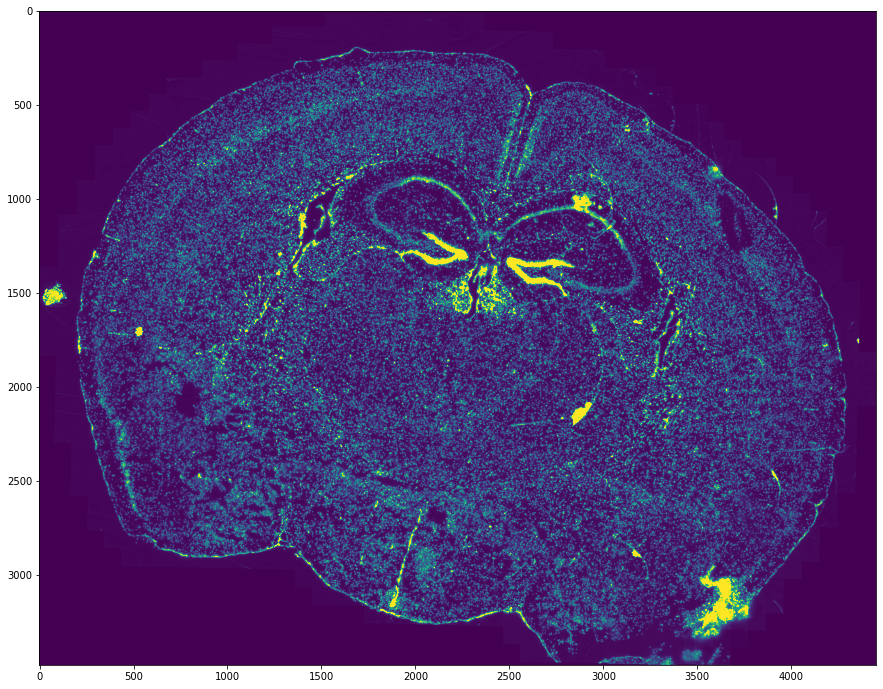

In [ ]:
# copy file to local computer
!gsutil cp {base_path}{dataset_name}images/mosaic_DAPI_z{z_index_number}.tif mosaic_DAPI_z{z_index_number}.tif
print('copied image')

# load image
image = tifffile.imread('mosaic_DAPI_z' + str(z_index_number) + '.tif')
print('loaded image')
scale_percent = 5 # percent of original size
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
dim = (width, height)
  
# make reduced size image to avoid running out of memory
resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
tifffile.imsave('fov_image.tif', image[minCoord[1]:maxCoord[1], minCoord[0]:maxCoord[0]])
image = None

plt.figure(figsize=(15,15))
plt.imshow(resized, vmax=30000)

## Plot detected transcripts

The .csv files (detected_transcripts.csv) contain the list of all detected transcripts in
the sample where each row is a detected transcript. The column names and
descriptions of what the column represents are:
1.   barcode_id - internally used id of the gene. Each gene has a unique barcode_id
2.   global_x, global_y - The global micron x and y coordinates of this transcript
3.   x, y - The pixel coordinates of this transcript within the field of view
4.   global_z - The index of the z slice that this transcript was detected in. Each z
slice is separated by 1.5 microns
5.   fov - the index of the field of view where this transcript was detected
6.   gene - the gene name of this detected transcript

Below we load the detected_transcripts.csv file and plot the position of all transcripts. We then filter to plot only the transcripts from Gad1.

/usr/local/lib/python3.7/dist-packages/numpy/lib/arraysetops.py:580: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


Text(0, 0.5, 'Y (microns)')

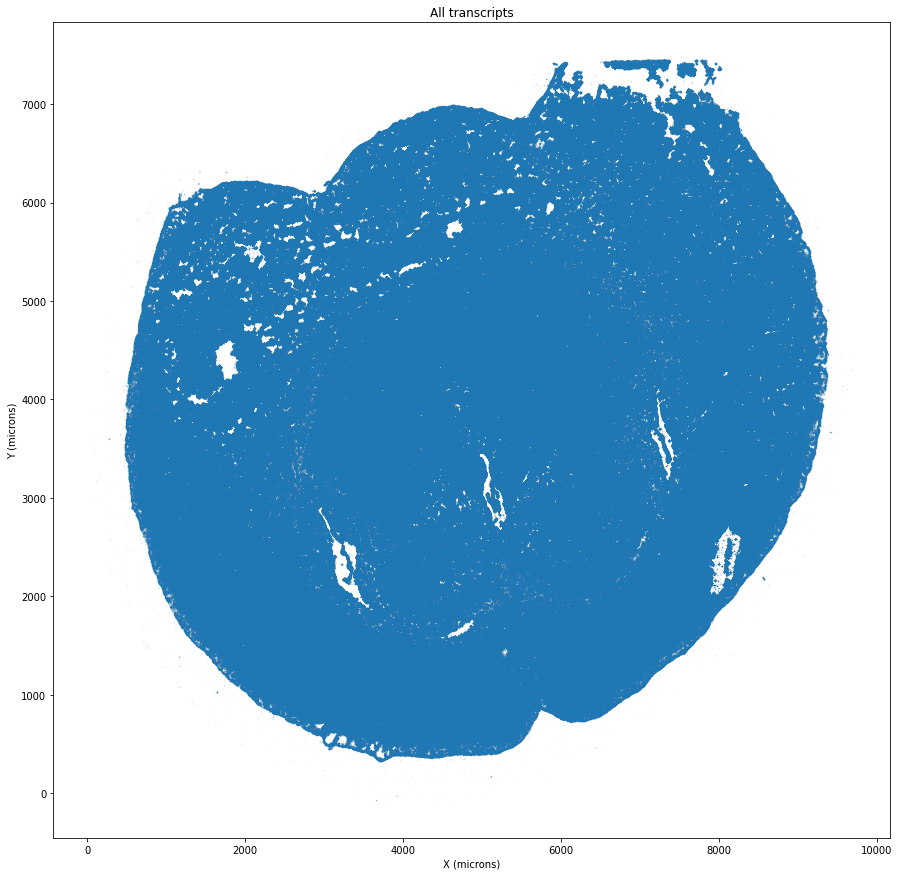

In [ ]:
transcripts = pd.read_csv(base_path + dataset_name + 'detected_transcripts' + dataset_suffix + '.csv', index_col=0)
plt.figure(figsize=(15,15))
plt.scatter(transcripts.global_x, transcripts.global_y, alpha=0.1, s=0.1)
plt.title('All transcripts')
plt.xlabel('X (microns)')
plt.ylabel('Y (microns)')

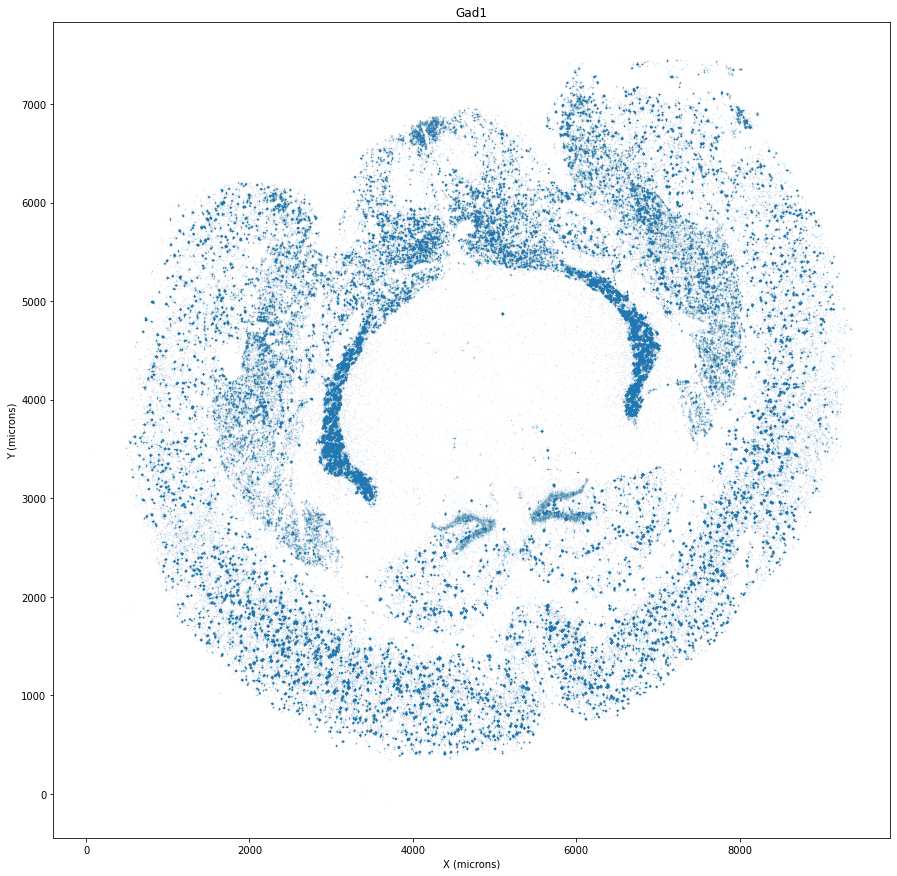

In [ ]:

plt.figure(figsize=(15,15))
plt.scatter(transcripts[transcripts['gene'] == 'Gad1'].global_x, transcripts[transcripts['gene'] == 'Gad1'].global_y, alpha=0.1, s=0.1)
plt.title('Gad1')
plt.xlabel('X (microns)')
plt.ylabel('Y (microns)')

## Plot transcripts, cell boundaries, and DAPI for a single field of view

### Transform coordinates to mosaic pixel coordinates 

In [ ]:
%%capture
!pip install -q observable_jupyter
from observable_jupyter import embed
from PIL import Image
import base64
from io import BytesIO

# transcripts
#########################
transcripts = transcripts[transcripts['fov'] == fov].copy()
temp = transcripts[['global_x', 'global_y']].values
transcript_positions = np.ones((temp.shape[0], temp.shape[1]+1))
transcript_positions[:, :-1] = temp
transformed_positions = np.matmul(transformation_matrix, np.transpose(transcript_positions))[:-1]
transcripts.loc[:, 'local_x'] = transformed_positions[0, :]
transcripts.loc[:,'local_y'] = transformed_positions[1, :]
image = tifffile.imread('fov_image.tif')

# segmentation data
#########################
polygon_data = []
for inst_index in range(len(currentCells)):
  inst_cell = currentCells[inst_index]
  df_poly_z = pd.DataFrame(inst_cell).transpose()
  df_poly_z.columns.tolist()
  inst_name = meta_cell.iloc[inst_index].name
  inst_poly = {'coordinates': df_poly_z.values.tolist(), 'name': inst_name}
  polygon_data.append(inst_poly)

df_obs = transcripts[['local_x', 'local_y', 'global_z', 'gene']]
df_obs.columns = ['x', 'y', 'z', 'name']
scatter_data = df_obs.to_dict('records')  

def make_image_url(image_data):
    buffered = BytesIO()
    noise_img = Image.fromarray(image_data, 'RGB')
    noise_img.save(buffered, format="PNG")
    noise_img_str = base64.b64encode(buffered.getvalue())
    noise_url = '"data:image/png;base64,'+ str(noise_img_str)[2:-1] + '"'    
    return noise_url      

# image background
#########################
vmax=30000
tmpImage = deepcopy(np.flip(image, axis=0))
tmpImage[tmpImage > vmax] = vmax
tmpImage = tmpImage * (255/vmax)
tmpImage[tmpImage > 255] = 255
tmpImage = tmpImage.astype(np.int)

image_data = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)
image_data[:,:, 0] = tmpImage
image_data[:,:, 1] = tmpImage
image_data[:,:, 2] = tmpImage    
image_url = make_image_url(image_data)    

# gene colors
#################
cats = df_obs.name.unique().tolist()
colors = []
for inst_index in range(len(cats)):
  if 'Blank' in cats[inst_index]:
    colors.append('#d3d3d3')
  else:
    mod_index = inst_index % 60
    if mod_index < 20:
      color_rgba = plt.cm.tab20(mod_index % 20)
    elif mod_index < 40:
      color_rgba = plt.cm.tab20b(mod_index % 20)
    elif mod_index < 60:
      color_rgba = plt.cm.tab20b(mod_index % 20)
    inst_color = '#{:02x}{:02x}{:02x}'.format( int(color_rgba[0]* 255), int(color_rgba[1]* 255), int(color_rgba[2]* 255)) 
    colors.append(inst_color)
cat_colors = dict(zip(cats, colors))


The below interactive plot shows DAPI staining (background image), segmented cells (red borders), and transcripts (points) for a single field of view from the experiment. Users can zoom/pan and mouseover to identify the transcript gene names. The plot can be visualized in 2D or 3D - 3D enables users to see the Z-level of transcripts. Cell segmentation is shown for a single Z-level.


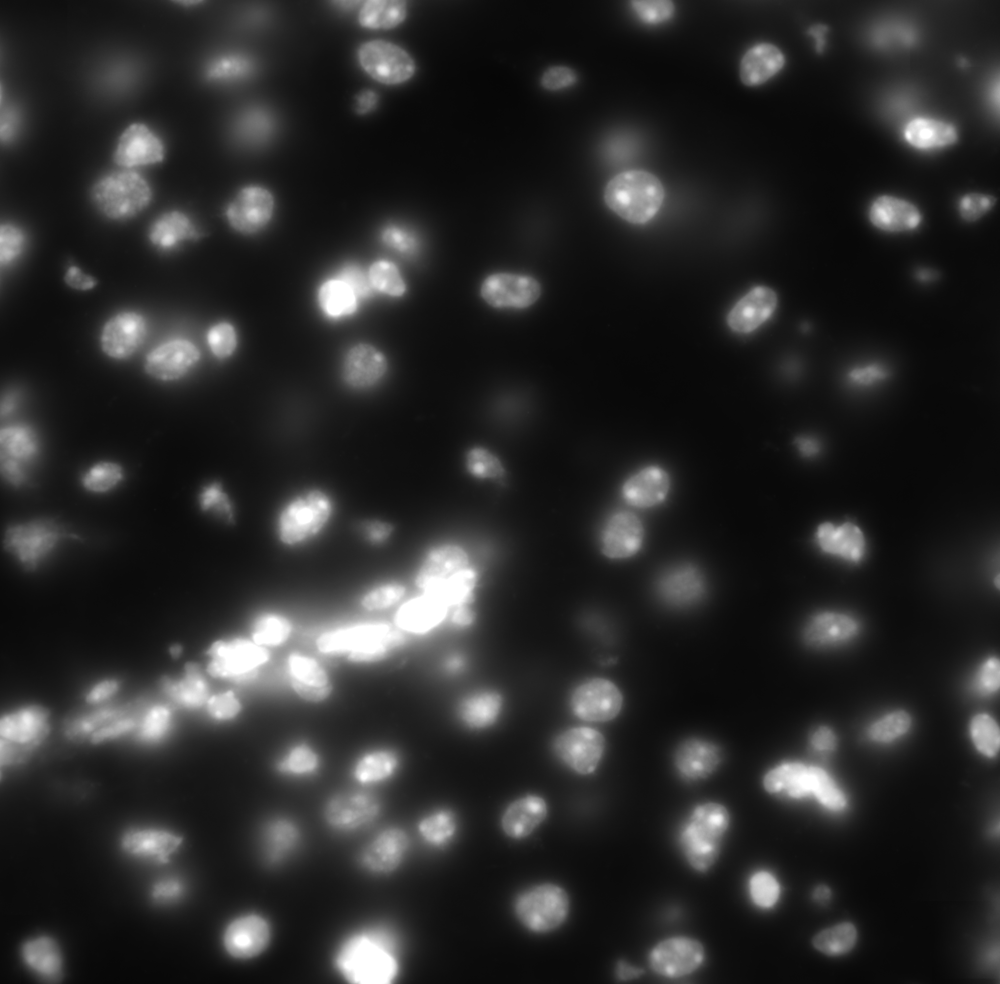

In [ ]:
x_offset = np.float(minCoord[0])
y_offset = np.float(minCoord[1])
image_bounds = [[x_offset, y_offset], [x_offset, y_offset + image.shape[0]], [x_offset + image.shape[1], y_offset + image.shape[0]], [x_offset + image.shape[1], y_offset]]

notebook_name = '@vizgen/deck-gl-image-polygon-scatter-3d'
embed(notebook_name, cells=['dashboard'], inputs={
    'polygon_data': polygon_data,
    'scatter_data': scatter_data,
    'center_x': np.mean([minCoord[0], maxCoord[0]]), 
    'center_y': np.mean([minCoord[1], maxCoord[1]]), 
    'image': image_url,
    'image_bounds': image_bounds,
    'zoom': -1.5, 
    'min_zoom': -3,
    'height': 800, 
    'ini_view_type': '2D', 
    'cat_colors': cat_colors
    })

## Single Cell Analysis

Vizgen MERSCOPE automatically segments the cells in the MERFISH measurement. This immediately enables single cell analysis.

The key files for single cell analysis are:

### cell_by_gene
A matrix of cells by genes (cell columns and gene rows) indicating the number of measured transcripts of each gene detected within each cell.

### cell_metadata

The cell metadata file contains the spatial metadata for each of the detected cells, including the following columns:

* fov: the field of view where the cell was visualized
* volume: the volume of the cell in global coordinates
* center_x: the center of the cell in the x coordinate
* center_y: the center of the cell in the y coordinate	
* min_x: the minimum position of the cell in the x coordinate
* max_x: the maximum position of the cell in the x coordinate	
* min_y: the maximum position of the cell in the y coordinate	
* max_y: the maximum position of the cell in the y coordinate	
* barcodeCount: the number of transcript in the cell

### Install and import dependencies



In [ ]:
# install requirements
!pip install -q fsspec
!pip install -q gcsfs
!pip install -q scanpy
!pip install -q leidenalg
!pip install -q observable_jupyter
!pip install -q clustergrammer2
!pip install -q loompy

     |████████████████████████████████| 10.3MB 6.4MB/s 
     |████████████████████████████████| 81kB 6.4MB/s 
     |████████████████████████████████| 133kB 53.3MB/s 
     |████████████████████████████████| 1.2MB 48.8MB/s 
     |████████████████████████████████| 71kB 6.1MB/s 
     |████████████████████████████████| 1.4MB 5.2MB/s 
     |████████████████████████████████| 3.2MB 45.8MB/s 
     |████████████████████████████████| 18.8MB 1.2MB/s 
     |████████████████████████████████| 51kB 3.9MB/s 
     |████████████████████████████████| 112kB 7.4MB/s 


In [ ]:
import pandas as pd
import scanpy as sc
import tifffile
from matplotlib import pyplot as plt
from observable_jupyter import embed
from clustergrammer2 import net, Network, CGM2
from scipy.stats.stats import pearsonr   
from copy import deepcopy

# Avoids scroll-in-the-scroll in the entire Notebook
from IPython.display import Javascript
def resize_colab_cell():
  display(Javascript('google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'))
get_ipython().events.register('pre_run_cell', resize_colab_cell)

>> clustergrammer2 backend version 0.17.2


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


### Load cell by gene matrix and cell metadata and construct AnnData object

In [ ]:
%%time
cell_by_gene = pd.read_csv(base_path + dataset_name + 'cell_by_gene' + dataset_suffix + '.csv', index_col=0)
meta_cell = pd.read_csv(base_path + dataset_name + 'cell_metadata' + dataset_suffix + '.csv', index_col=0)
meta_cell['barcodeCount'] = cell_by_gene.sum(axis=1)

ad_viz = sc.AnnData(X=cell_by_gene.values, obs=meta_cell)

<IPython.core.display.Javascript object>

CPU times: user 7.15 s, sys: 2.08 s, total: 9.23 s
Wall time: 18.1 s


## Cluster Vizgen Gene Expression Data
Here we load the Vizgen single cell gene expression data into Scanpy to perform preprocessing (normalization and log transformation), dimensionality reduction (PCA, neighbohood calculation, UMAP), and clustering (Leiden clustering)

In [ ]:
%%capture

resolution = 1.0

# Leiden Clustering
######################
sc.pp.normalize_total(ad_viz)
sc.pp.log1p(ad_viz)
sc.pp.scale(ad_viz, max_value=10)
sc.tl.pca(ad_viz, svd_solver='arpack')
sc.pp.neighbors(ad_viz, n_neighbors=10, n_pcs=20)
sc.tl.umap(ad_viz)
sc.tl.leiden(ad_viz, resolution=1.0)

# Calculate Leiden Signatures
#########################################
ser_counts = ad_viz.obs['leiden'].value_counts()
ser_counts.name = 'cell counts'
meta_leiden = pd.DataFrame(ser_counts)

cat_name = 'leiden'
sig_leiden = pd.DataFrame(columns=ad_viz.var_names, index=ad_viz.obs[cat_name].cat.categories)                                                                                                 
for clust in ad_viz.obs[cat_name].cat.categories: 
    sig_leiden.loc[clust] = ad_viz[ad_viz.obs[cat_name].isin([clust]),:].X.mean(0)
sig_leiden = sig_leiden.transpose()
leiden_clusters = ['Leiden-' + str(x) for x in sig_leiden.columns.tolist()]
sig_leiden.columns = leiden_clusters
meta_leiden.index = sig_leiden.columns.tolist()

# generate colors for categories by plotting
sc.pl.umap(ad_viz, color="leiden", legend_loc='on data')
cats = ad_viz.obs['leiden'].cat.categories.tolist()
colors = list(ad_viz.uns['leiden_colors'])
cat_colors = dict(zip(cats, colors))

<IPython.core.display.Javascript object>

### Visualize gene expression heatmap
The heatmap shows the average expression of the leiden clusters.

In [ ]:
net = Network(CGM2)
net.load_df(sig_leiden, meta_col=meta_leiden, col_cats=['cell counts'])
net.filter_threshold(0.01, axis='row')
net.normalize(axis='row', norm_type='zscore')
net.cluster()
embed('@vizgen/clustergrammer-gl', cells=['clustergrammer'], inputs={'network': net.viz})

<IPython.core.display.Javascript object>

### Visualize UMAP and spatial cell coordinates

Here we visualize Vizgen single cell gene expression data using an interacive scatterplot that: cells can be positioned based on their dimensionality reduced UMAP embedding or based on their spatial position. Cells can also be colored based on Leiden cluster or the expression of genes.

In [ ]:
# genes to overlay on scatterplot
viz_genes = ad_viz.var['std'].sort_values(ascending=False).index.tolist()[:5]
viz_genes

<IPython.core.display.Javascript object>

['384', '374', '377', '379', '134']

In [ ]:
df_pos = ad_viz.obs[['center_x', 'center_y', 'leiden']]
df_pos.columns = ['x', 'y', 'leiden']
df_umap = ad_viz.obsm.to_df()[['X_umap1', 'X_umap2']]
df_umap.columns = ['umap-x', 'umap-y']

df_gex = ad_viz[:, viz_genes].to_df()
df_name = pd.DataFrame(df_gex.index.tolist(), index=df_gex.index.tolist(), columns=['name'])
df_obs = pd.concat([df_name, df_pos, df_umap, df_gex], axis=1)

data = df_obs.to_dict('records')
url = '@vizgen/deck-gl-jupyter-spatial-and-umap'
inputs = {
    'data': data, 
    'zoom': -3.75, 
    'ini_cat': 'leiden',
    'cat_colors': cat_colors}
embed(url, cells=['dashboard'], inputs=inputs) 
del data

<IPython.core.display.Javascript object>